In [1]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.12.0
Hub version: 0.13.0
GPU available (YESS!!!!)


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [65]:
import pandas as pd
import numpy as np
labels_csv = pd.read_csv("/content/drive/MyDrive/dog-breed-identification (4)/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


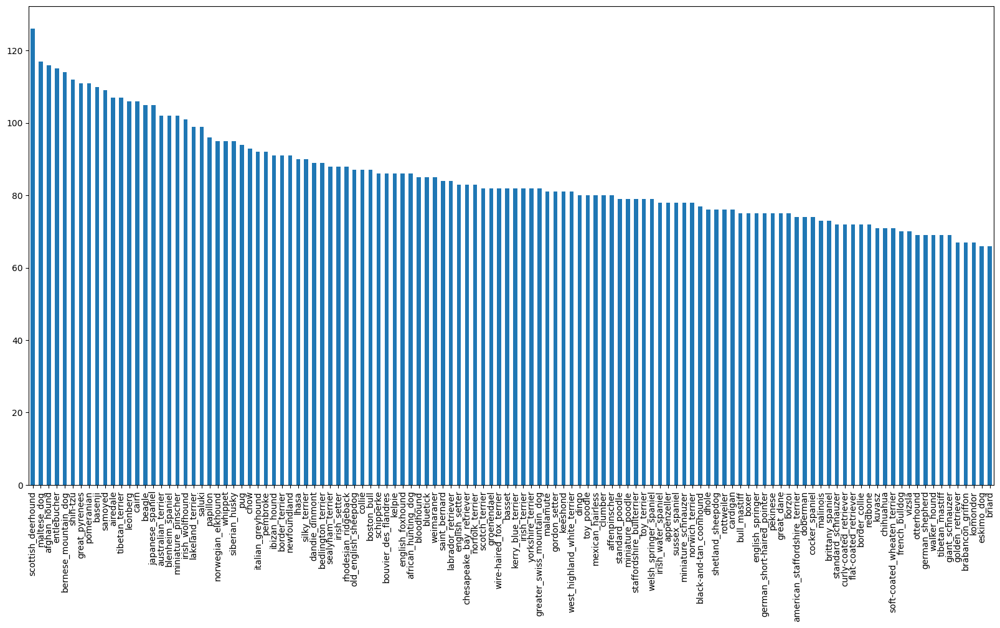

In [4]:
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

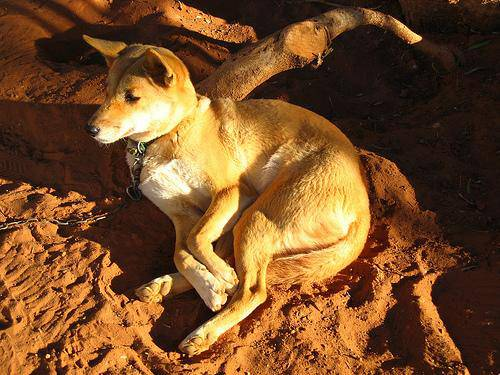

In [37]:
from IPython.display import display, Image
Image("/content/drive/MyDrive/dog-breed-identification (4)/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

In [44]:
# Create pathnames from image ID's
filenames = ["/content/drive/MyDrive/dog-breed-identification (4)/train/" + fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10 filenames
filenames[:10]

['/content/drive/MyDrive/dog-breed-identification (4)/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [7]:
#import os
#os.listdir("/content/drive/MyDrive/dog-breed-identification (4)/train")

['e81e8496a9826236ee5dfb24960aec6d.jpg',
 'e7678fac0b8f1d97e742644ee75a8aa2.jpg',
 'e779a2c3d07afb0056a1e33298e9eecf.jpg',
 'e86a88391d017cc3807cc9653a4a7290.jpg',
 'e866558cded733e2788c68b170752f59.jpg',
 'e7ab74acdc860dfb93271901da085ffd.jpg',
 'e86503273b282ab18bd09c6b6ef63de7.jpg',
 'e7518def797fd4193bebc97d52ecd66f.jpg',
 'e7f2f67cb616281a89fc77a6bdea6eb0.jpg',
 'e76687c549303fb57aae9866739f44b8.jpg',
 'e7faa5748d8320f604aeb3fd5bbe4ab0.jpg',
 'e78fc6d10f9d4646a50004e4ac74ea5c.jpg',
 'e7f6ec634384c07f7a0f5659e4f77867.jpg',
 'e827550ea6ab19bbd4916d9952ee8765.jpg',
 'e7a8a3681524405b2e987ffbaff6d173.jpg',
 'e78ff6b0a2d3a58234760d45e984eccf.jpg',
 'e7bc17ef352ef576b73467ebe9a407f1.jpg',
 'e79f822b26adace4455db1fcd94ab47e.jpg',
 'e79c6a88cf8da397ee67235a04741f2d.jpg',
 'e81b2d682dd2a2f5900b07551297f0a5.jpg',
 'e81ff379277f5023333efed3beda7f64.jpg',
 'e7af30693df78697b8541fb5e2e46941.jpg',
 'e79a196a6e1772b9fa6b008b597d3a08.jpg',
 'e76ab0b6cd07a1583ef84a2d4dc98aca.jpg',
 'e79011daac8075

In [89]:
# Check whether number of filenames matches number of actual image files
import os
if (len(os.listdir("/content/drive/MyDrive/dog-breed-identification (4)/train")) == len(filenames)):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory.")

Filenames match actual amount of files!


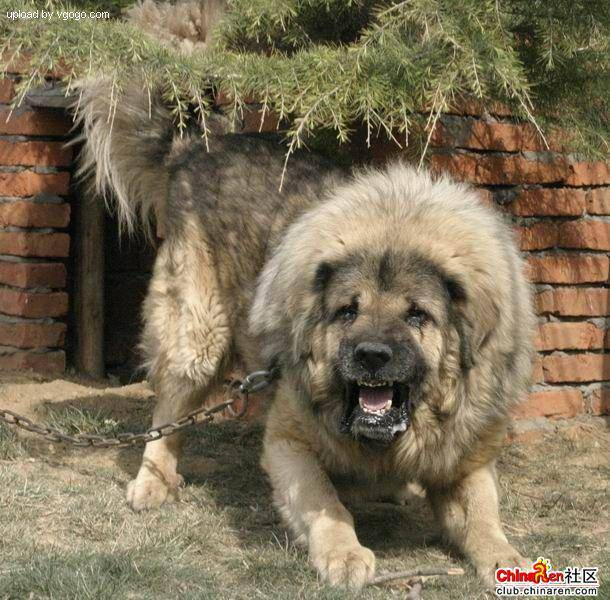

In [90]:
Image(filenames[9000])

In [91]:
import numpy as np
labels = labels_csv["breed"].to_numpy() # convert labels column to NumPy array
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [92]:
len(labels)

10222

In [93]:
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


In [94]:
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [95]:
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [96]:
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [97]:
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])[0][0]) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [98]:
X = filenames
y = boolean_labels

In [99]:
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [100]:
from sklearn.model_selection import train_test_split

# Split them into training and validation using NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train),len(y_train),len(X_val),len(y_val)

(800, 800, 200, 200)

In [101]:
X_train[:5], y_train[:2]

(['/content/drive/MyDrive/dog-breed-identification (4)/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/dog-breed-identification (4)/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/dog-breed-identification (4)/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/dog-breed-identification (4)/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/dog-breed-identification (4)/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, Fa

In [102]:
from matplotlib.pyplot import imread
image = imread(filenames[42]) # read in an image
image.shape

(257, 350, 3)

In [103]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [104]:
IMG_SIZE = 224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

In [105]:
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [106]:
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [107]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [108]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [113]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")




In [110]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

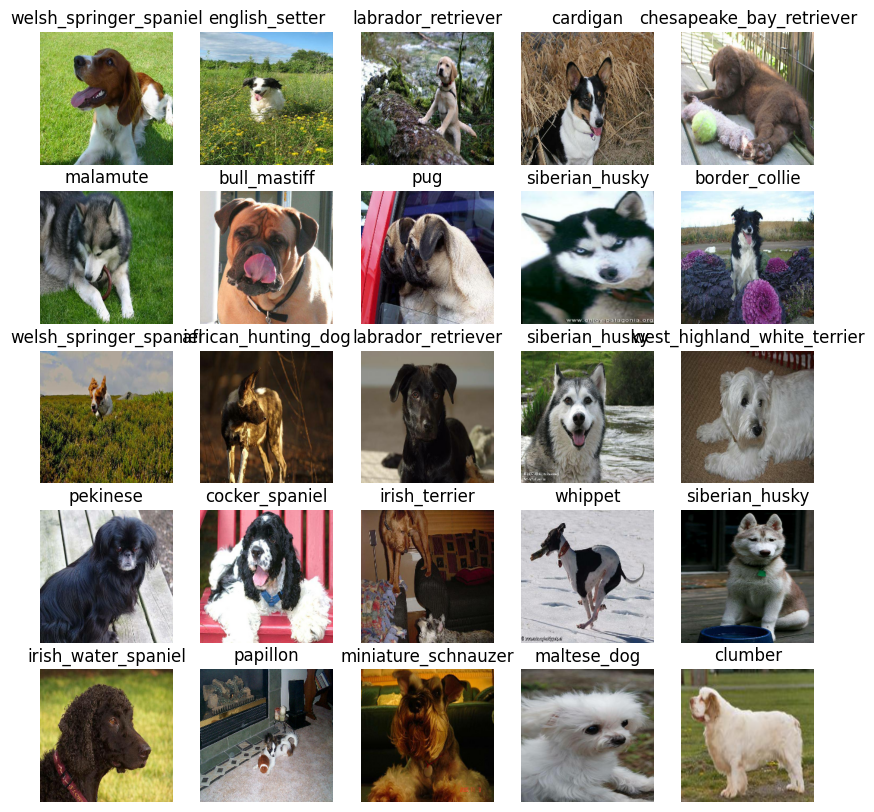

In [114]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

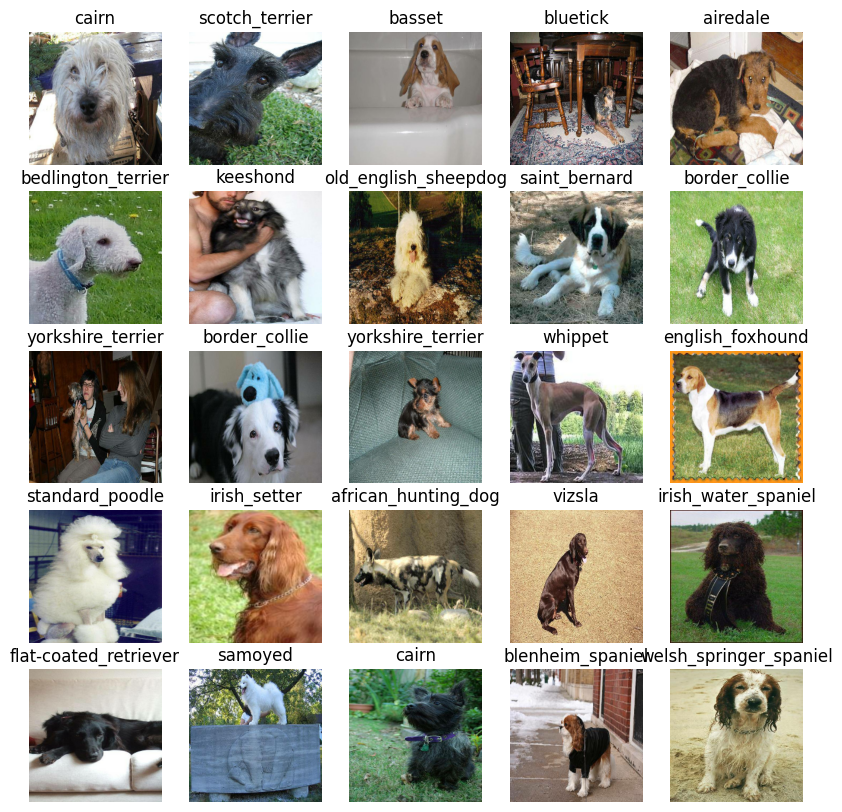

In [115]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)


In [116]:
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [117]:
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [118]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_1 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


In [119]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [120]:
import datetime
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/My Drive/Data/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [121]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of

In [122]:
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "no tavailable :(")

GPU available (YESS!!!!)


In [123]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [124]:
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])

  return model

In [126]:
import datetime
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 137s 4s/step - loss: 4.6212 - accuracy: 0.0962 - val_loss: 3.4354 - val_accuracy: 0.2700
Epoch 2/100
25/25 [==============================] - 3s 135ms/step - loss: 1.6691 - accuracy: 0.6625 - val_loss: 2.2311 - val_accuracy: 0.4700
Epoch 3/100
25/25 [==============================] - 7s 281ms/step - loss: 0.5808 - accuracy: 0.9237 - val_loss: 1.6883 - val_accuracy: 0.6000
Epoch 4/100
25/25 [==============================] - 3s 115ms/step - loss: 0.2533 - accuracy: 0.9875 - val_loss: 1.5140 - val_accuracy: 0.6200
Epoch 5/100
25/25 [==============================] - 3s 115ms/step - loss: 0.1482 - accuracy: 0.9962 - val_loss: 1.4482 - val_accuracy: 0.6250
Epoch 6/100
25/25 [==============================] - 3s 114ms/step - loss: 0.1018 - accuracy: 1.0000 - val_loss: 1.4042 - val_accuracy: 0.6500
Epoch 7/100
25/25 [==============================]

In [127]:
%tensorboard --logdir drive/My\ Drive/Data/logs

<IPython.core.display.Javascript object>

In [128]:
predictions = model.predict(val_data, verbose=1) # verbose shows us how long there is to go
predictions

7/7 [==============================] - 5s 92ms/step


array([[5.3285959e-04, 5.7659863e-04, 8.5930596e-04, ..., 3.4492373e-04,
        1.7408945e-05, 1.5134560e-02],
       [4.1997670e-03, 2.8682849e-04, 4.6210308e-03, ..., 6.2776729e-04,
        2.0965399e-02, 1.6139635e-04],
       [1.4705610e-05, 8.1737971e-06, 5.8415746e-05, ..., 1.2628907e-05,
        2.2581193e-05, 2.3604628e-04],
       ...,
       [1.5668349e-05, 6.9419417e-04, 1.4556861e-04, ..., 6.8390014e-05,
        2.1960812e-05, 8.0260128e-04],
       [1.0656046e-02, 8.4468711e-04, 2.5579912e-04, ..., 1.2537205e-04,
        9.9309582e-05, 8.2787676e-03],
       [2.8849320e-04, 2.1616119e-05, 3.6187482e-04, ..., 1.6916987e-03,
        6.4832682e-04, 8.2137360e-04]], dtype=float32)

In [129]:
predictions.shape

(200, 120)

In [130]:
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[5.32859587e-04 5.76598628e-04 8.59305961e-04 7.56575828e-05
 6.20800245e-04 6.18467602e-05 6.04567155e-02 3.08190356e-04
 3.81030055e-04 1.26642454e-03 2.63226742e-04 1.89705723e-04
 7.17719260e-04 1.81711686e-04 4.11403191e-04 2.87112198e-04
 1.38497460e-04 6.29392117e-02 4.03175909e-05 9.03007967e-05
 2.67945020e-03 3.17476457e-04 1.54657446e-05 5.75171784e-03
 1.39013737e-05 9.78437456e-05 2.29277998e-01 2.52211670e-04
 6.04449131e-04 4.76031928e-05 8.27858676e-05 4.82515636e-04
 2.37233704e-04 7.03172045e-05 8.10711121e-04 6.33728355e-02
 1.82125455e-04 6.82488026e-04 6.70685477e-05 1.68120660e-05
 1.32704200e-03 1.00776779e-05 4.66349848e-05 4.50669002e-04
 3.53205396e-05 7.24352431e-05 3.68926485e-05 8.14169471e-04
 6.97783486e-04 3.75836593e-04 3.16677557e-04 2.05342221e-05
 8.29342403e-04 2.12782106e-04 2.33543717e-04 3.02640019e-05
 1.27245707e-03 3.44472076e-03 1.01646734e-03 6.00008443e-02
 5.19474735e-04 1.62077369e-04 2.56200554e-03 4.55034096e-05
 5.16012544e-04 1.044895

In [131]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'cairn'

In [132]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [133]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

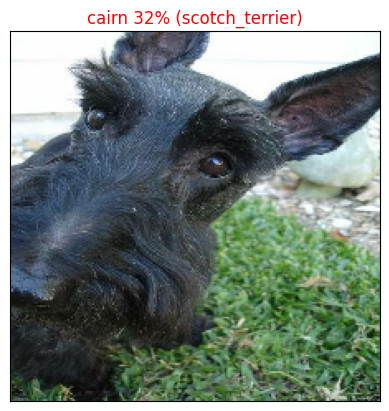

In [134]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

In [135]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

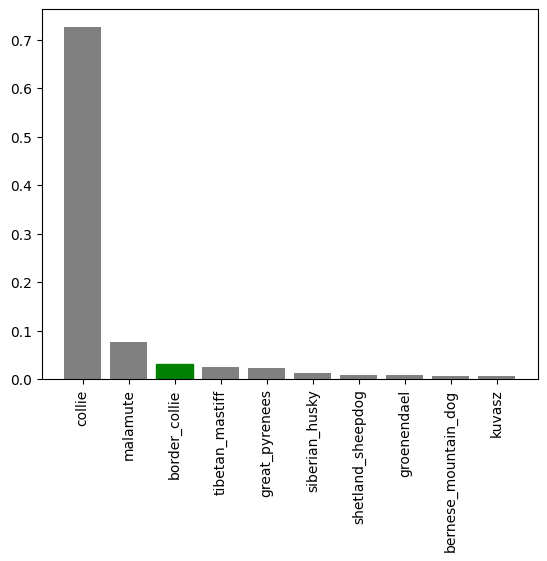

In [136]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

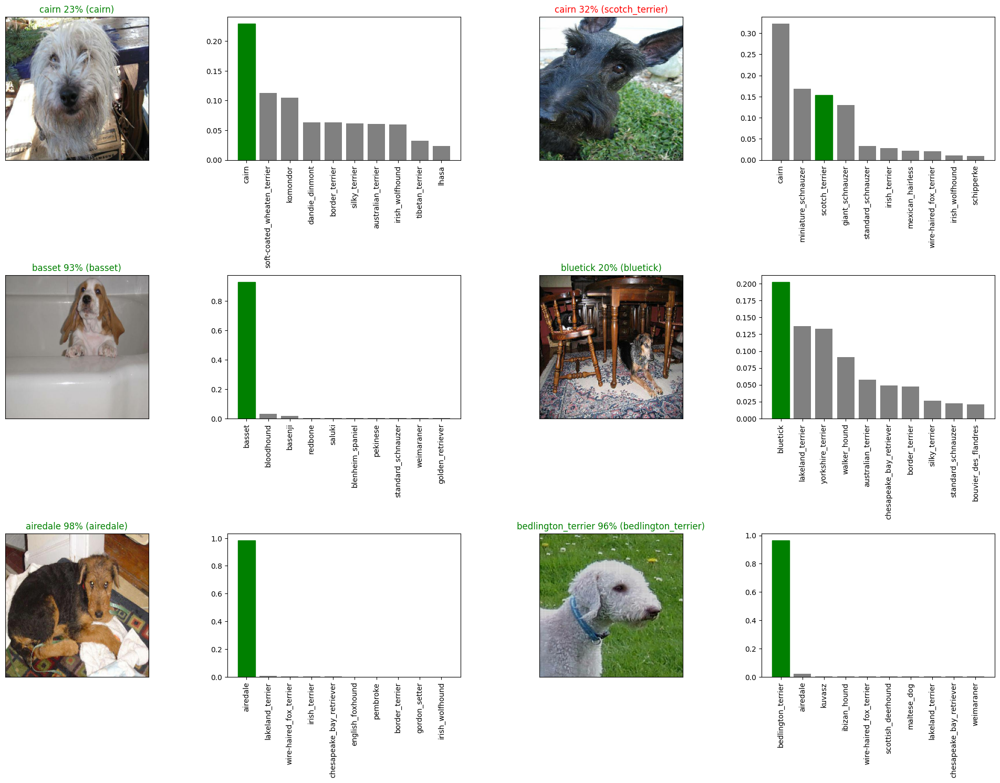

In [137]:
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [138]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/My Drive/Data/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [139]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [140]:
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/My Drive/Data/models/20230629-11281688038138-1000-images-Adam.h5...


'drive/My Drive/Data/models/20230629-11281688038138-1000-images-Adam.h5'

In [173]:
model_1000_images = load_model('/content/drive/MyDrive/Data/models/20230629-11281688038138-1000-images-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Data/models/20230629-11281688038138-1000-images-Adam.h5


In [142]:
model.evaluate(val_data)

7/7 [==============================] - 1s 127ms/step - loss: 1.3189 - accuracy: 0.6700


[1.3189003467559814, 0.6700000166893005]

In [174]:
model_1000_images.evaluate(val_data)

7/7 [==============================] - 1s 92ms/step - loss: 1.3189 - accuracy: 0.6700


[1.3189003467559814, 0.6700000166893005]

In [144]:
len(X), len(y)

(10222, 10222)

In [145]:
full_data = create_data_batches(X, y)

Creating training data batches...


In [146]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [147]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [148]:
%tensorboard --logdir drive/My\ Drive/Data/logs

Reusing TensorBoard on port 6006 (pid 34190), started 0:02:08 ago. (Use '!kill 34190' to kill it.)

<IPython.core.display.Javascript object>

In [149]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 1035s 3s/step - loss: 1.3539 - accuracy: 0.6665
Epoch 2/100
320/320 [==============================] - 33s 104ms/step - loss: 0.3994 - accuracy: 0.8819
Epoch 3/100
320/320 [==============================] - 33s 103ms/step - loss: 0.2377 - accuracy: 0.9355
Epoch 4/100
320/320 [==============================] - 33s 104ms/step - loss: 0.1544 - accuracy: 0.9636
Epoch 5/100
320/320 [==============================] - 33s 102ms/step - loss: 0.1070 - accuracy: 0.9773
Epoch 6/100
320/320 [==============================] - 35s 111ms/step - loss: 0.0761 - accuracy: 0.9871
Epoch 7/100
320/320 [==============================] - 33s 102ms/step - loss: 0.0590 - accuracy: 0.9920
Epoch 8/100
320/320 [==============================] - 33s 102ms/step - loss: 0.0458 - accuracy: 0.9948
Epoch 9/100
320/320 [==============================] - 34s 106ms/step - loss: 0.0381 - accuracy: 0.9967
Epoch 10/100
320/320 [==============================] - 32s 101ms

In [150]:
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/My Drive/Data/models/20230629-12011688040070-all-images-Adam.h5...


'drive/My Drive/Data/models/20230629-12011688040070-all-images-Adam.h5'

In [153]:
loaded_full_model = load_model('/content/drive/MyDrive/Data/models/20230629-11281688038138-1000-images-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Data/models/20230629-11281688038138-1000-images-Adam.h5


In [160]:
test_path = "/content/drive/MyDrive/dog-breed-identification (4)/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['/content/drive/MyDrive/dog-breed-identification (4)/test/e7afb35b8252782013a6700e28e327fa.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e721c3eec5951861bf3ed7f40ef8b091.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e7dc8cc599049ea9fa2a172c88646c57.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e76a7a1d23d687b5015b07df762c0c10.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e76a58909e6e1196bdefb3105060bcbe.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e7b357150635c250757363718e4dae86.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e73efb021b7b49e328b2159d34060b82.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e751e319cfdc9912ae2e5da2a9b053e0.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e752d87634c6177a748d655a55aeec89.jpg',
 '/content/drive/MyDrive/dog-breed-identification (4)/test/e806fbb5ca4dd3a094f7819bd810cc65.jpg']

In [161]:
len(test_filenames)

10357

In [162]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [163]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 146s 439ms/step


In [164]:
test_predictions[:10]

array([[1.6127122e-04, 1.2554259e-04, 4.4775158e-04, ..., 1.6067858e-03,
        2.2988755e-03, 1.2428344e-04],
       [1.2149976e-03, 2.5054608e-03, 4.8756375e-04, ..., 7.8057863e-05,
        1.2067922e-04, 4.4382279e-04],
       [1.3821163e-03, 4.1446552e-04, 1.6087103e-04, ..., 5.8078225e-05,
        2.0007553e-04, 4.9376820e-04],
       ...,
       [8.9528066e-06, 7.0520855e-06, 1.4560180e-05, ..., 9.9575427e-06,
        4.1080589e-04, 9.3209765e-06],
       [4.3416158e-03, 4.3883399e-04, 2.4572773e-05, ..., 5.7291886e-06,
        5.0894928e-06, 1.5683501e-03],
       [5.8701071e-03, 1.5610211e-04, 2.3669322e-04, ..., 2.4506636e-03,
        1.5435734e-01, 2.4895061e-02]], dtype=float32)

In [165]:
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [166]:
test_path = "/content/drive/MyDrive/dog-breed-identification (4)/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e7afb35b8252782013a6700e28e327fa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e721c3eec5951861bf3ed7f40ef8b091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e7dc8cc599049ea9fa2a172c88646c57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e76a7a1d23d687b5015b07df762c0c10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e76a58909e6e1196bdefb3105060bcbe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [167]:
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e7afb35b8252782013a6700e28e327fa,1.612712e-04,1.255426e-04,0.000448,1.855492e-02,0.000011,0.000153,0.000100,0.000125,0.000030,...,0.006895,0.000826,0.000580,0.000445,0.000297,0.000594,0.000779,0.001607,0.002299,0.000124
1,e721c3eec5951861bf3ed7f40ef8b091,1.214998e-03,2.505461e-03,0.000488,2.984857e-05,0.000142,0.002454,0.000164,0.001533,0.000171,...,0.004618,0.000099,0.000044,0.000616,0.001288,0.000537,0.000083,0.000078,0.000121,0.000444
2,e7dc8cc599049ea9fa2a172c88646c57,1.382116e-03,4.144655e-04,0.000161,1.217055e-04,0.000680,0.001162,0.000996,0.000381,0.000216,...,0.000312,0.007140,0.000084,0.000519,0.000174,0.004120,0.000074,0.000058,0.000200,0.000494
3,e76a7a1d23d687b5015b07df762c0c10,4.280332e-07,1.113504e-07,0.000023,1.107355e-06,0.000002,0.000005,0.000025,0.005482,0.000021,...,0.000004,0.000053,0.000002,0.000018,0.000003,0.000003,0.000002,0.000024,0.000021,0.000001
4,e76a58909e6e1196bdefb3105060bcbe,1.487276e-06,4.512405e-04,0.000031,2.161369e-07,0.000012,0.000055,0.000014,0.000151,0.000001,...,0.000006,0.000007,0.000009,0.000005,0.000004,0.000015,0.000108,0.000005,0.000004,0.000031


In [168]:
preds_df.to_csv("drive/My Drive/Data/full_submission_1_mobilienetV2_adam.csv",
                 index=False)

In [169]:
custom_path = "/content/drive/MyDrive/Data/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [170]:
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


In [171]:
custom_preds = loaded_full_model.predict(custom_data)

FailedPreconditionError: ignored

In [172]:
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

NameError: ignored

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

In [ ]:
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)